# Array measurements ROBAT 226.238:
- 5 mic array adafruit 5 i2s 
- 48khz 
- 1.5 meters distance (~ far field = 10𝛌; 𝛌max = fmin; 343/2 = 171 Hz --> 10𝛌 = 1715 Hz; at 1000Hz: 4.5𝛌 = 4.5*0.343 = 1.5435 m)
- measured clockwise (R: 0-180; L: 180-360)
- array rotated around the central mic kept a 1.5m from source

**HW settings:**
- Harman kandon AWR 445 vol = -25 db (front: 270 to 90)
- Harman kandon AWR 445 vol = -5 db (back: 100 to 260)
- fireface analog out 1/2 stereo vol = 0db
- tweeter #1
- Ref mic: gras +30 db fireface channel 9, +20db channel A power module

**NOTE:**


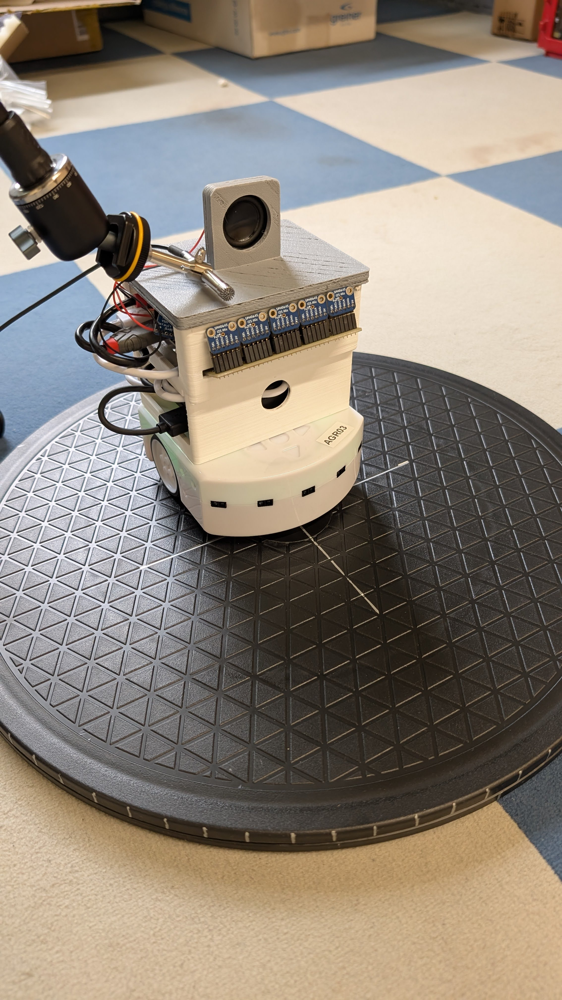

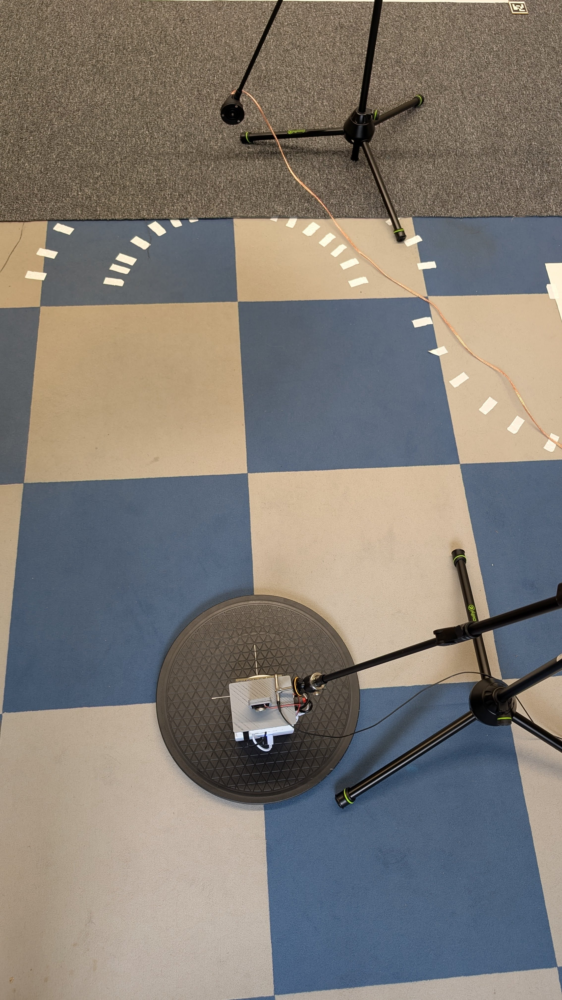

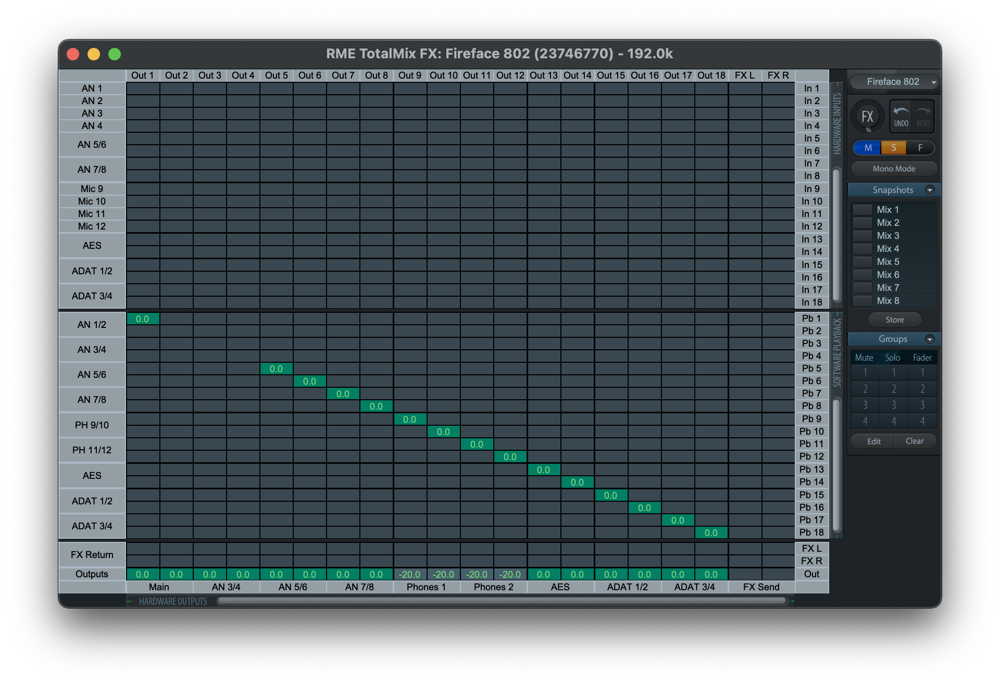

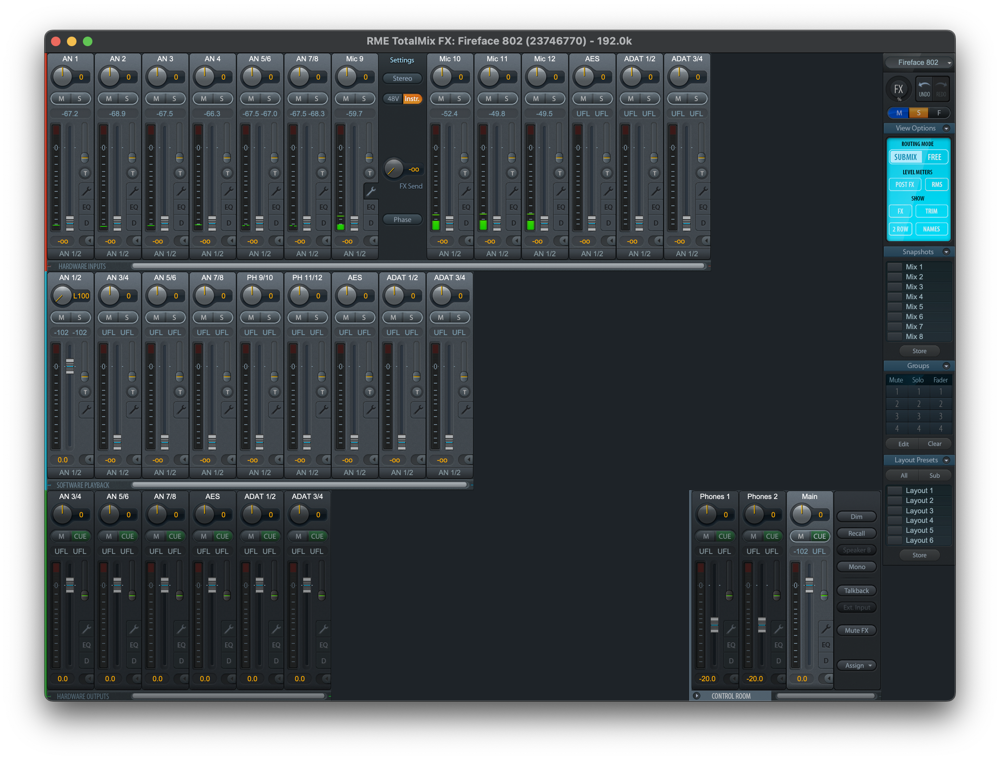

In [1]:
from IPython.display import Image
from IPython.display import display

display(
    Image(filename="./PXL_20250509_10061094.jpg", width=300),
    Image(filename="./PXL_20250509_10062195.jpg", width=300),
    Image(filename="./rme802_matrix.png", width=700),
    Image(filename="./rme802_mixer.png", width=700)
)

# Output signal
Out signal used during the recordings: 1-40Khz 5ms sweep.

/home/alberto/miniconda3/envs/robat2/lib/python3.11/site-packages/matplotlib/axes/_axes.py:7947: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


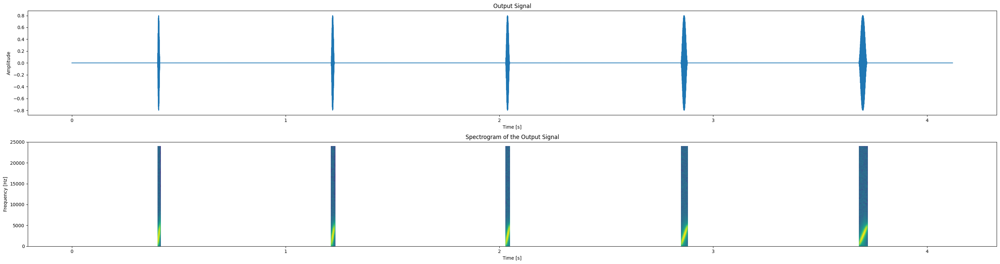

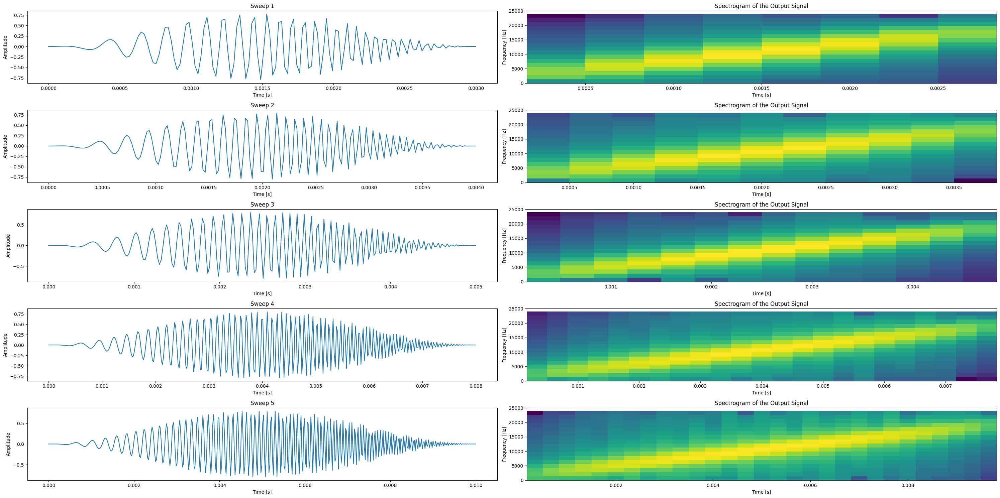

In [2]:
import scipy.signal as signal 
import numpy as np 
import matplotlib.pyplot as plt 
import sounddevice as sd
import soundfile as sf

# Set this variable to True to print, False to skip printing
do_print = False

#%%
# make a sweep
durns = np.array([3, 4, 5, 8, 10] )*1e-3
fs = 48000 # Hz

chirp = []
all_sweeps = []
for durn in durns:
    t = np.linspace(0, durn, int(fs*durn))
    start_f, end_f = 1e3, 20e3
    sweep = signal.chirp(t, start_f, t[-1], end_f)
    sweep *= signal.windows.tukey(sweep.size, 0.95)
    sweep *= 0.8
    sweep_padded = np.pad(sweep, pad_width=[int(fs*0.1)]*2, constant_values=[0,0])
    all_sweeps.append(sweep_padded)
    chirp.append(sweep)
    

sweeps_combined = np.concatenate(all_sweeps)

# Read the saved WAV file
out_signal, _ = sf.read('1_20k_5sweeps.wav')

# Plot the time-domain signal and spectrogram
plt.figure(figsize=(30, 8))

# Time-domain plot
plt.subplot(2, 1, 1)
plt.plot(np.linspace(0, len(out_signal) / fs, len(out_signal)), out_signal)
plt.title('Output Signal')
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')

# Spectrogram plot
plt.subplot(2, 1, 2, sharex=plt.gca())
plt.specgram(out_signal, Fs=fs, NFFT=512, noverlap=256, cmap='viridis')
plt.title('Spectrogram of the Output Signal')
plt.xlabel('Time [s]')
plt.ylabel('Frequency [Hz]')
plt.ylim(0, 25e3)
plt.tight_layout()

# plot the chirp
plt.figure(figsize=(30, 15))
for i, sweep in enumerate(chirp):
    plt.subplot(len(chirp), 2, 2 * i + 1)
    plt.plot(np.linspace(0, len(sweep) / fs, len(sweep)), sweep)
    plt.title(f'Sweep {i+1}')
    plt.xlabel('Time [s]')
    plt.ylabel('Amplitude')
    # Spectrogram plot

    plt.subplot(len(chirp), 2, 2 * i + 2)
    plt.specgram(sweep, Fs=fs, NFFT=32, noverlap=16, cmap='viridis')
    plt.title('Spectrogram of the Output Signal')
    plt.xlabel('Time [s]')
    plt.ylabel('Frequency [Hz]')
    plt.ylim(0, 25e3)

plt.tight_layout()
plt.show()


# Analysis

1. Angular audiofile import and extraction from multiwav to single channel recordings


In [3]:
# %% Libraries and files
import os
import soundfile as sf

# Load audio files, then plot a 6x6 grid
DIR = "./2025-05-09/original/"  # Directory containing the audio files
audio_files = os.listdir(DIR)  # List all files in the sweeps directory
audio_files.sort()  # Sort the files in ascending order

# Directory to save the extracted channels
output_dir = "./2025-05-09/extracted_channels/"
os.makedirs(output_dir, exist_ok=True)  # Create the directory if it doesn't exist

# Path to the multi-channel WAV file
for file in audio_files:
    file_path = os.path.join(DIR, file)

    angle_name = file.split('.')[0]
    if do_print:
        print(f"Processing file: {angle_name}")

    # Read the multi-channel WAV file
    audio_data, sample_rate = sf.read(DIR + file)

    # Check the shape of the audio data
    if do_print:
        print(f"Audio data shape: {audio_data.shape}")  # (samples, channels)

    # Extract individual channels
    num_channels = audio_data.shape[1]  # Number of channels
    channels = [audio_data[:, i] for i in range(num_channels)]

    # Save each channel as a separate WAV file
    for i, channel_data in enumerate(channels):
        output_file = os.path.join(output_dir + "channel_separation", angle_name+f"_{i + 1}.wav")  # Path to the output file
        sf.write(output_file, channel_data, sample_rate)
        if do_print:
            print(f"Saved channel {i + 1} to {output_file}")


2. Sorting of the angular extracted files into the separate channels

In [4]:
# List all extracted channel files separated by channel number
from natsort import natsorted

# Directory containing the extracted channels
extracted_channels_dir = "./2025-05-09/extracted_channels/channel_separation/"

# List all extracted channel files
channel_files = os.listdir(extracted_channels_dir)

# Filter out directories and non-audio files, keep only valid files
channel_files = [f for f in channel_files if os.path.isfile(os.path.join(extracted_channels_dir, f)) and f.endswith('.wav')]

# Sort the files naturally by the last part of their names (e.g., channel number)
sorted_channel_files = natsorted(channel_files, key=lambda x: int(x.split('_')[-1].split('.')[0]))

# Group files by the last part of their name (channel number)
grouped_files = {}

for file in sorted_channel_files:
    # Extract the channel number from the file name (e.g., "350_1.wav" -> "1")
    channel_number = int(file.split('_')[-1].split('.')[0])

    # Group files by channel number
    if channel_number not in grouped_files:
        grouped_files[channel_number] = []
    grouped_files[channel_number].append(file)

for i in range(len(grouped_files)):
    grouped_files[i+1].sort()

# Print grouped files
if do_print:
    for channel_number, files in grouped_files.items():
        print(f"Channel {channel_number}:")
        for f in files:
            print(f"  {f}")


3. Matched filtering:
 - Every file is matched with the output
 - First sweep is extracted and displayed
 - First sweep is saved to a new directory to be analyzed 
 - avarage RMS of all the sweep in every recording is saved

In [31]:
import scipy
import scipy.stats

gain = 20  # dB

db_to_linear = lambda X: 10**(X/20)
dB = lambda X: 20 * np.log10(abs(np.array(X).flatten()))

extracted_channels_dir = "./2025-05-09/extracted_channels/channel_separation/"
saving_dir = "./2025-05-09/extracted_channels/"

# Define the matched filter function
def matched_filter(recording, chirp_template):
    filtered_output = np.roll(signal.correlate(recording, chirp_template, 'same', method='direct'), -len(chirp_template)//2)
    filtered_output *= signal.windows.tukey(filtered_output.size, 0.1)
    filtered_envelope = np.abs(signal.hilbert(filtered_output))
    return filtered_envelope

# Detect peaks in the matched filter output
def detect_peaks(filtered_output):
    peaks, properties = signal.find_peaks(filtered_output, prominence=0.1, distance=0.2 * sample_rate)
    return peaks

# Dictionary to store RMS values for all files
rms_values_dict = {}

channel_number = 0
for i in range(len(grouped_files)):
    channel_number += 1
    files = grouped_files[i+1]
    if do_print:
        print(f"\nProcessing Channel {channel_number}:\n")
    
        # Create a new figure for each channel
        fig, ax = plt.subplots(figsize=(15, 5))
        ax.set_title(f"Channel {channel_number}", fontsize=20)
        ax.set_xlabel("Seconds")
        ax.set_ylabel("Amplitude")
        ax.grid(True)

    for file in files[0:len(files)]:
        file_path = os.path.join(extracted_channels_dir, file)
        recording, sample_rate = sf.read(file_path)

        angle_name = int(file.split('_')[0])

        if 100 <= angle_name <= 260:  
            recording *= db_to_linear(-gain)

        # Apply matched filtering for each chirp template
        for idx_chirp, chirp_template in enumerate(chirp):
            filtered_output = matched_filter(recording, chirp_template)

            # Detect peaks
            peaks = detect_peaks(filtered_output)
            if do_print:
                print(f"Peaks detected in {file}: {len(peaks)} with {idx_chirp+1} chirp template")

                ax.plot(np.linspace(0, len(filtered_output) / sample_rate, len(filtered_output)), filtered_output, label=f"Filtered Output - {file}")
                #ax.plot(np.linspace(0, len(filtered_envelope) / sample_rate, len(filtered_envelope)), filtered_envelope, label=f"Filtered env - {file}", color='orange')
                ax.plot(np.linspace(0, len(recording) / sample_rate, len(recording)), recording, label=f"rec - {file}")
                #ax.legend(loc='upper right')
                #ax.set_xlim(5.15, 5.18)
                ax.set_xlim(2, 7)

                # Plot peaks on the filtered output
                ax.plot(peaks / sample_rate, filtered_output[peaks], "x", label="Detected Peaks")
                #ax.legend(loc='upper right')
            rms_values = []
            if len(peaks) > 0:
                # Extract the first sweep
                sweep_start = peaks[idx_chirp]
                sweep_end = sweep_start + len(chirp_template)
                sweep = recording[sweep_start:sweep_end]

                # Calculate RMS value of the first sweep
                rms = np.sqrt(np.mean(sweep**2))
                rms_values.append(rms)

                if do_print:
                    print(f"RMS value of sweep at peak {peaks[idx_chirp]/sample_rate} sec in {file}: {rms:.5f}")
                # Process each channel
                DIR_sweep = saving_dir + f"sweep_{idx_chirp+1}/"  # Directory to save the first sweeps
                os.makedirs(DIR_sweep, exist_ok=True)  # Create the directory if it doesn't exist

                sf.write(DIR_sweep + file, sweep, int(sample_rate))
                
                # Store RMS value in the dictionary
                rms_values_dict[file] = np.mean(rms_values)

                # # Calculate RMS values for all detected peaks
                # if do_print:
                #     print(f"Average RMS value of all sweeps in {file}: {average_rms:.5f}")


            else:
                if do_print:
                    print(f"No sweeps detected in {file} - Channel {channel_number}")
    

# plt.show(block = False)

# Print the dictionary of RMS values

# if do_print:
#     print("\nRMS Values for All Files:")
#     for file, rms_value in rms_values_dict.items():
#         print(f"{file}: {rms_value:.5f}")

4. RMS values of the *whole file* is calculated and displayed in a polar plot

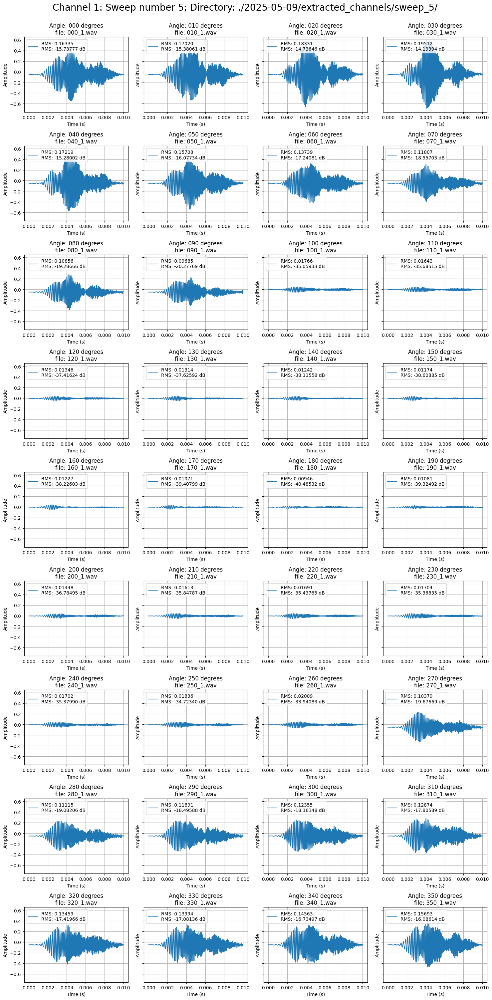

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


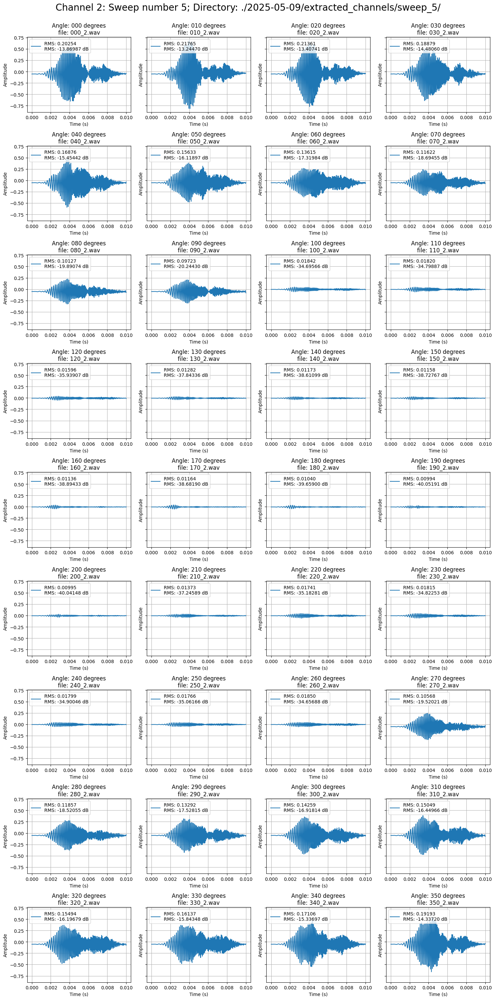

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


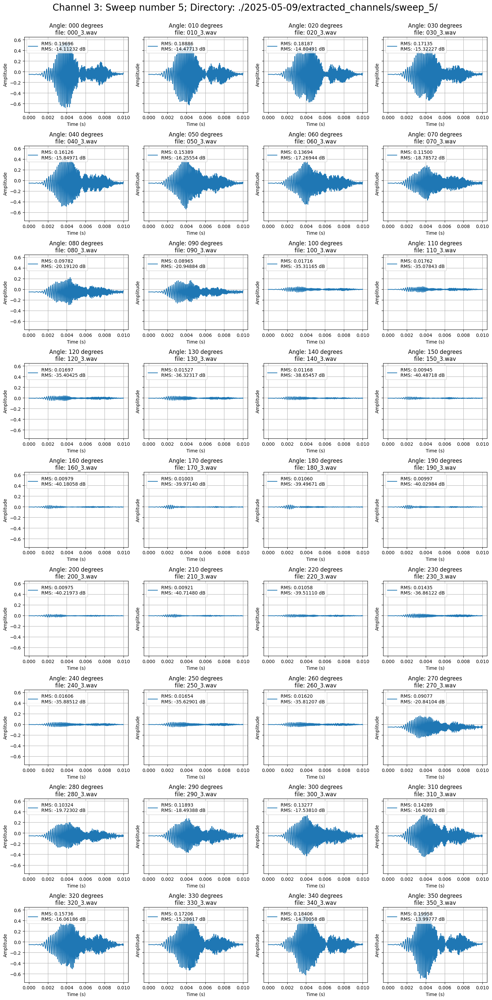

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


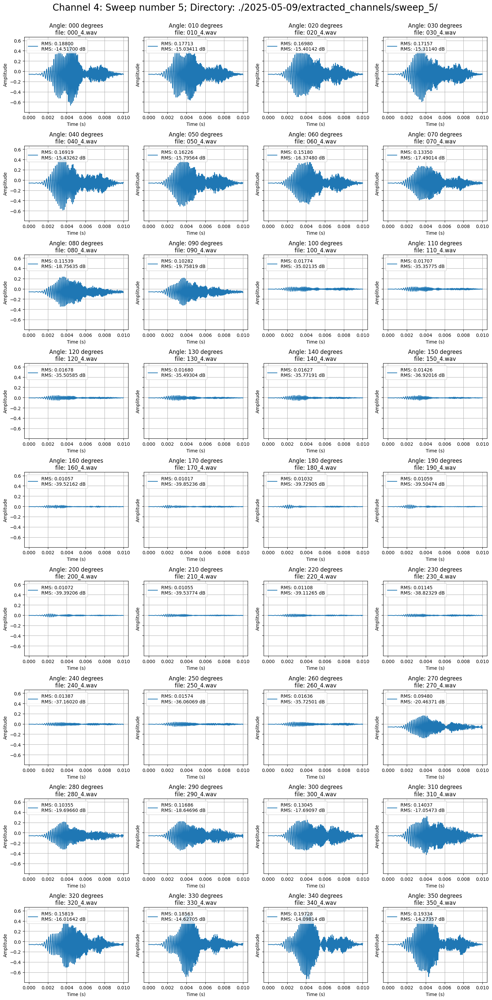

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


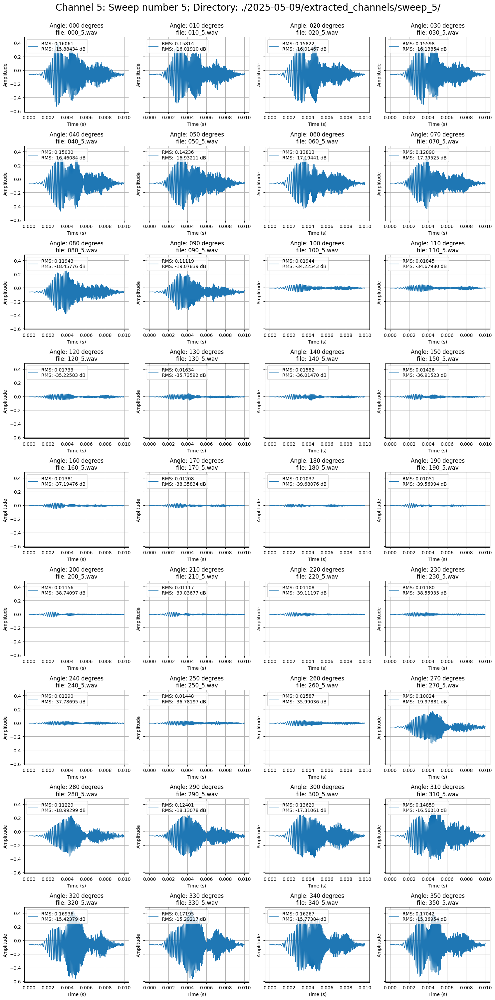

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.



RMS Values for All Files:
000_1.wav: 0.16335
010_1.wav: 0.17020
020_1.wav: 0.18331
030_1.wav: 0.19512
040_1.wav: 0.17219
050_1.wav: 0.15708
060_1.wav: 0.13739
070_1.wav: 0.11807
080_1.wav: 0.10856
090_1.wav: 0.09685
100_1.wav: 0.01766
110_1.wav: 0.01643
120_1.wav: 0.01346
130_1.wav: 0.01314
140_1.wav: 0.01242
150_1.wav: 0.01173
160_1.wav: 0.01226
170_1.wav: 0.01070
180_1.wav: 0.00945
190_1.wav: 0.01080
200_1.wav: 0.01447
210_1.wav: 0.01613
220_1.wav: 0.01691
230_1.wav: 0.01704
240_1.wav: 0.01702
250_1.wav: 0.01835
260_1.wav: 0.02009
270_1.wav: 0.10379
280_1.wav: 0.11115
290_1.wav: 0.11891
300_1.wav: 0.12355
310_1.wav: 0.12874
320_1.wav: 0.13459
330_1.wav: 0.13994
340_1.wav: 0.14563
350_1.wav: 0.15693
360_1.wav: 0.16335
000_2.wav: 0.20254
010_2.wav: 0.21765
020_2.wav: 0.21361
030_2.wav: 0.18879
040_2.wav: 0.16876
050_2.wav: 0.15633
060_2.wav: 0.13615
070_2.wav: 0.11622
080_2.wav: 0.10127
090_2.wav: 0.09723
100_2.wav: 0.01841
110_2.wav: 0.01820
120_2.wav: 0.01596
130_2.wav: 0.01281
140_

In [32]:
# Plot all angles, skipping '360'
angles = [file.split('_')[0] for file in files]  # Extract angle names from filenames

sweep_to_plot = 5
DIR_sweep = saving_dir + f"sweep_{sweep_to_plot}/"  # Directory to save the first sweeps

channel_number = 0
for i in range(len(grouped_files)):
    channel_number += 1
    files = grouped_files[i+1]
    # Plot all angles, skipping '360'
    fig1, axs = plt.subplots(9, 4, figsize=(15, 30), sharey=True)
    angles = [file.split('_')[0] for file in files]  # Extract angle names from filenames

    idx_to_plot = 0
    for idx, file in enumerate(files):
        if angles[idx] == '360':
            continue  # Skip the 360 angle

        file_path = os.path.join(DIR_sweep, file)
        audio, sample_rate = sf.read(file_path)

        rms = np.sqrt(np.mean(audio**2))
        rms_db = 20 * np.log10(rms)
        
        row = idx_to_plot // 4
        col = idx_to_plot % 4
        
        ax = axs[row, col]
        ax.plot(np.linspace(0, len(audio) / sample_rate, len(audio)), audio)
        ax.set_title(f"Angle: {angles[idx]} degrees\nfile: {file}")  # Use extracted angle name with units
        ax.set_xlabel("Time (s)")
        ax.set_ylabel(f"Amplitude")
        ax.grid(True)
        ax.legend([f'RMS: {rms:.5f}\nRMS: {rms_db:.5f} dB'], loc='upper left')

        idx_to_plot += 1
    # Add suptitle after plotting all subplots
    plt.suptitle(f"Channel {channel_number}: Sweep number {sweep_to_plot}; Directory: {DIR_sweep}", fontsize=20, y=1)
    plt.tight_layout()  # Adjust layout to make room for suptitle
    plt.show(block = False)

    ax.legend()

plt.show(block = False)

# Print the dictionary of RMS values
print("\nRMS Values for All Files:")
for file, rms_value in rms_values_dict.items():
    print(f"{file}: {rms_value:.5f}")


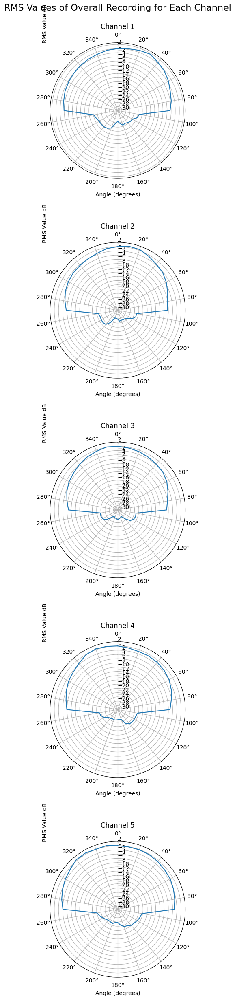

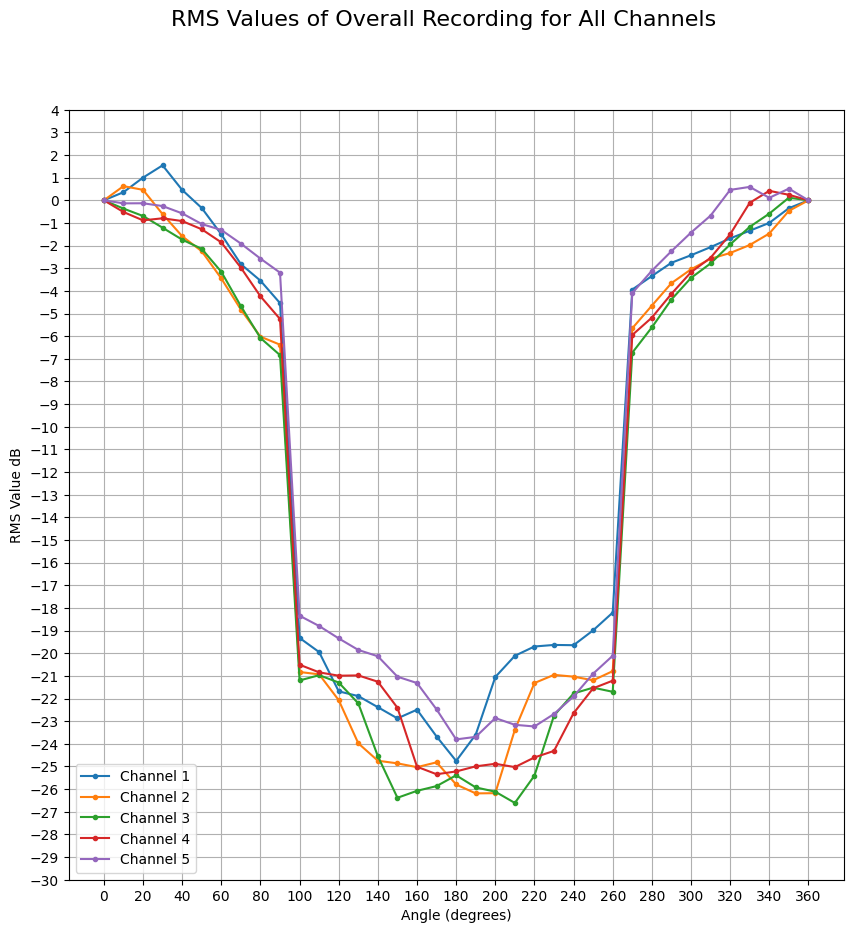

In [34]:
# RMS values of the overall recording for each channel and each angle

num_channels = len(grouped_files)
fig_polar, axs_polar = plt.subplots(num_channels, 1, figsize=( 5,25), subplot_kw={'projection': 'polar'})
fig_polar.suptitle("RMS Values of Overall Recording for Each Channel", fontsize=16)

fig_linear, ax_linear = plt.subplots(figsize=(10, 10))
fig_linear.suptitle("RMS Values of Overall Recording for All Channels", fontsize=16)

for i in range(num_channels):
    channel_number = i + 1
    files = grouped_files[channel_number]
    
    rms_values = []
    rms_values_norm_db = []
    angles = []
    
    for file in files:

        rms = rms_values_dict[file]
        
        rms_values.append(rms)

        rms_values_norm = rms_values / rms_values[0]
        rms_values_norm_db = 20 * np.log10(rms_values_norm)

        angle_name = file.split('_')[0]
        angles.append(int(angle_name))
    
    # Convert angles to radians
    angles_rad = np.radians(angles)
    
    # Plot RMS values in polar plot
    ax_polar = axs_polar[i] if num_channels > 1 else axs_polar
    ax_polar.plot(angles_rad, rms_values_norm_db, linestyle='-', label=f"Channel {channel_number}")
    ax_polar.set_title(f"Channel {channel_number}")
    ax_polar.set_theta_zero_location("N")  # Set 0 degrees to North
    ax_polar.set_theta_direction(-1)  # Set clockwise direction
    ax_polar.set_xticks(np.linspace(0, 2 * np.pi, 18, endpoint=False))  # Set angle ticks
    ax_polar.set_xlabel("Angle (degrees)")
    ax_polar.set_ylabel("RMS Value dB", position=(0, 1), ha='left')
    ax_polar.set_rlabel_position(0)
    ax_polar.set_yticks(np.arange(-30, 3, 2))  # Set y-ticks

    # Plot RMS values in linear plot
    ax_linear.plot(angles, rms_values_norm_db, marker='.', linestyle='-', label=f"Channel {channel_number}")
    ax_linear.set_xlabel("Angle (degrees)")
    ax_linear.set_xticks(np.linspace(0, 380, 19, endpoint=False))  # Set angle ticks
    ax_linear.set_ylabel("RMS Value dB")
    ax_linear.set_yticks(np.arange(-30, 5, 1))  # Set y-ticks
    ax_linear.legend()
    ax_linear.grid(True)

fig_polar.tight_layout()
plt.show(block = False)


5. Frequency analysis of every channel up to 40 KHz

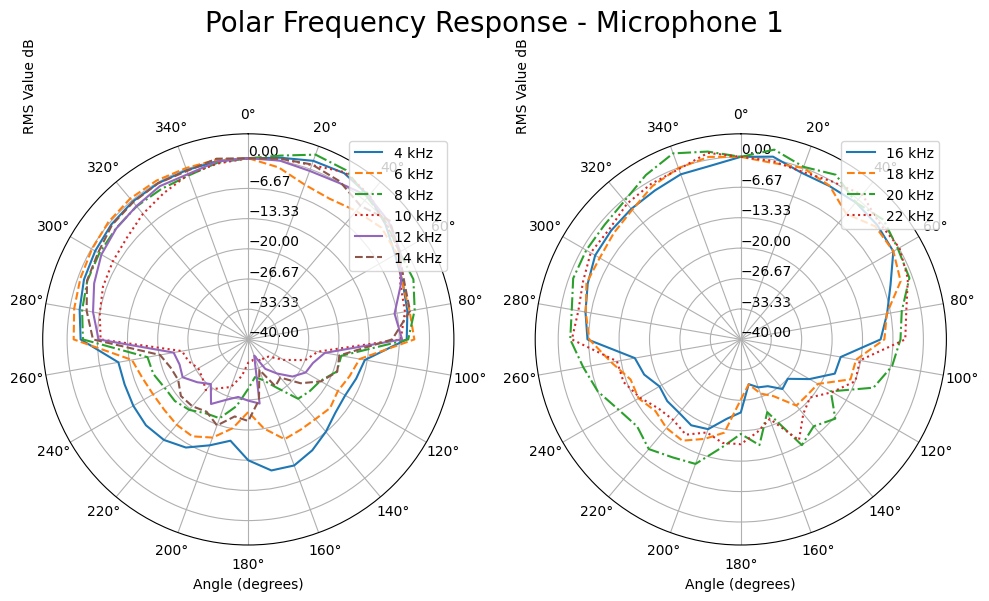

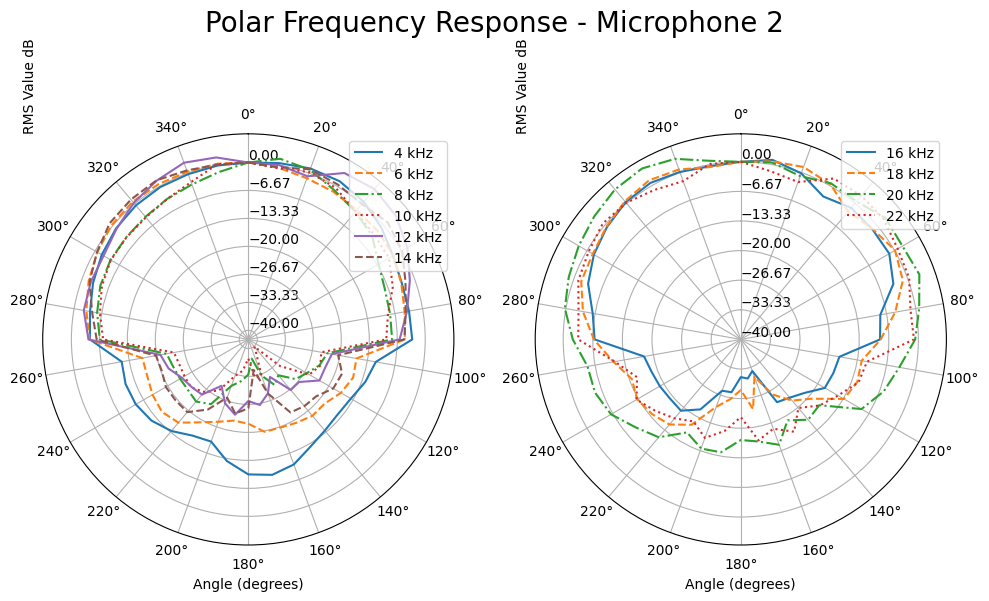

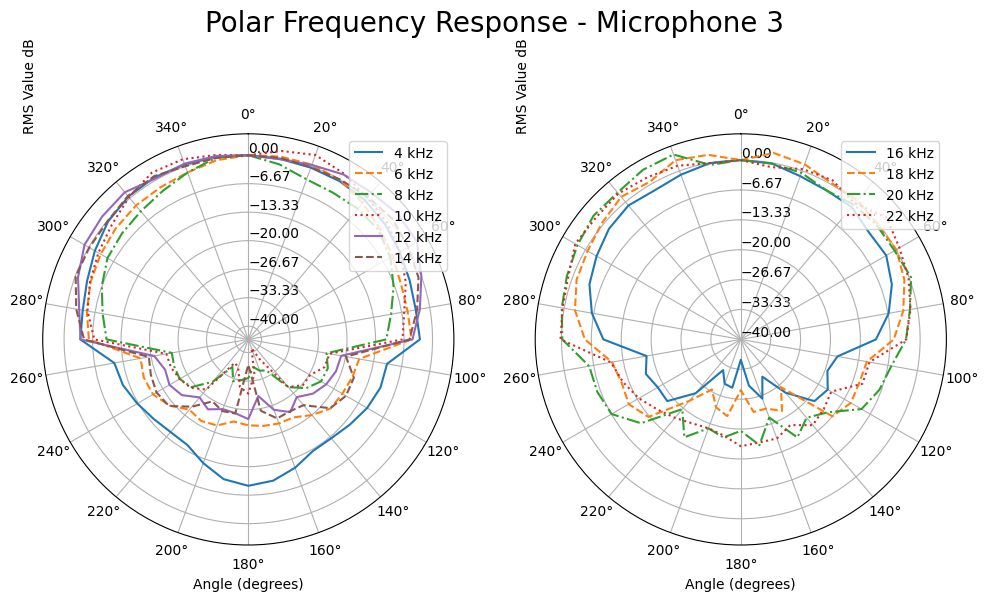

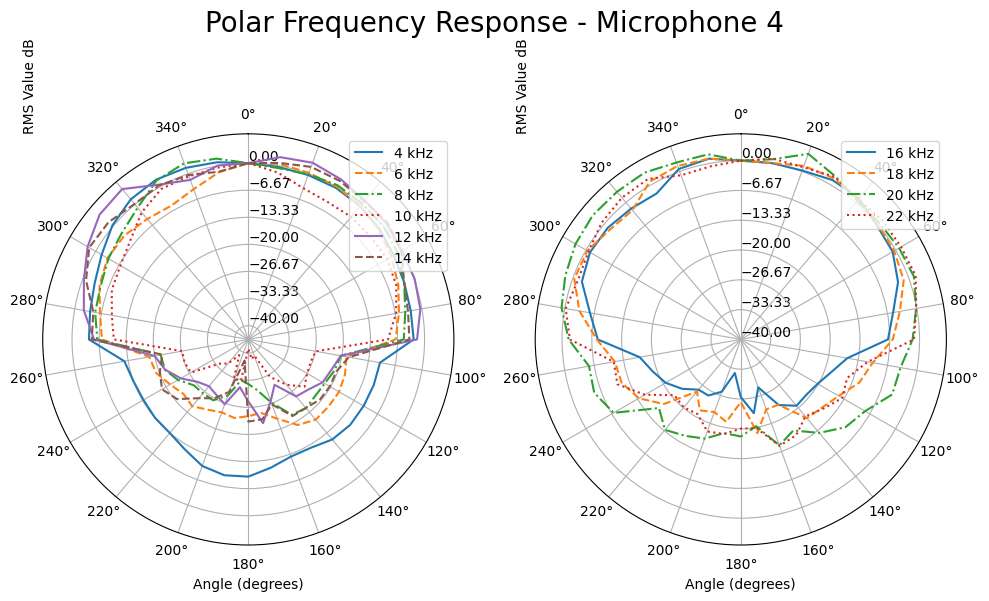

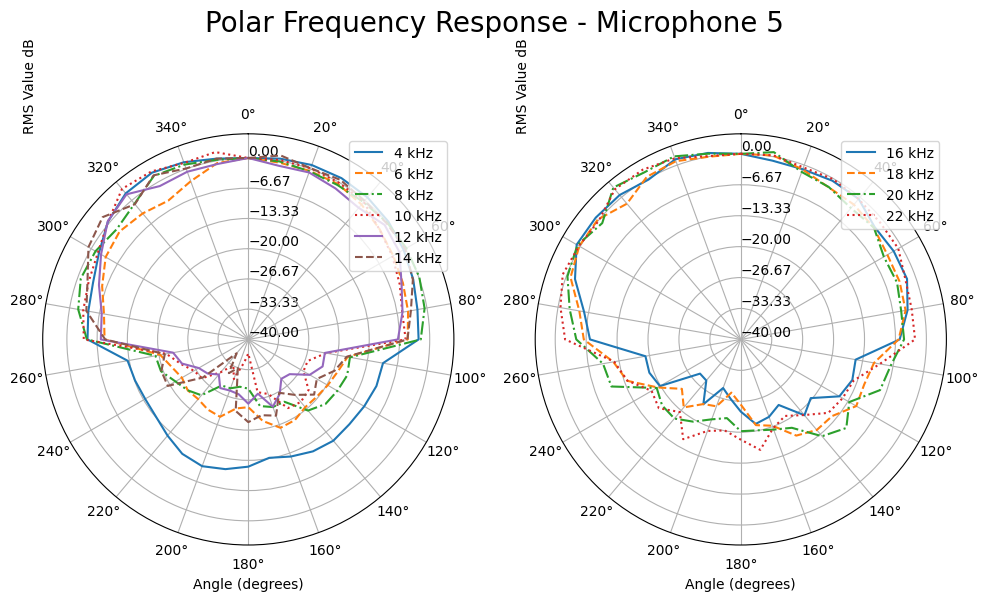

In [35]:
import soundfile as sf
from scipy import fft
# Central frequencies of the bands
central_freq = np.array([4e3, 6e3, 8e3, 10e3, 12e3, 14e3, 16e3, 18e3, 20e3, 22e3])
BW = 1e3  # Bandwidth of the bands
linestyles = ["-", "--", "-.", ":", "-", "--"]  # Line styles for the plot
# Group central frequencies into 3 sets of 6 bands each
num_bands_per_plot = 6
central_freq_sets = [central_freq[i * num_bands_per_plot:(i + 1) * num_bands_per_plot] for i in range(3)]
# Number of microphones
num_mics = num_channels
# Plot for each microphone
for mic in range(1, num_mics + 1):
    files = grouped_files[mic]
    angles = [int(file.split('_')[0]) for file in files]  # Extract angles from filenames
    # Create a figure with 3 polar subplots
    fig, axes = plt.subplots(1, 2, subplot_kw={"projection": "polar"}, figsize=(10, 6))
    plt.suptitle(f"Polar Frequency Response - Microphone {mic}", fontsize=20)
    for ax_idx, ax in enumerate(axes):
        ii = 0
        for fc in central_freq_sets[ax_idx]:
        
            audio_patt = []
            for file in files:
                file_path = os.path.join(DIR_sweep, file)
                audio, fs = sf.read(file_path)
                # Compute FFT
                audio_freq = fft.fft(audio, n=2048)
                audio_freq = audio_freq[:1024]
                freqs = fft.fftfreq(2048, 1 / fs)[:1024]
                # Compute mean radiance in the band
                band_mean = np.mean(np.abs(audio_freq[(freqs > fc - BW) & (freqs < fc + BW)]))
                audio_patt.append(band_mean)
            # Normalize and plot
            audio_patt_norm = audio_patt / audio_patt[0] # Normalize the radiance
            audio_patt_norm_dB = 20 * np.log10(audio_patt_norm) # Convert the radiance to dB
        
            if fc >= 10e3:
                label = f"{fc / 1e3:.0f} kHz"
            else:
                label = f"{fc / 1e3:.0f} kHz"
        
            ax.plot(np.deg2rad(angles), audio_patt_norm_dB, label=label, linestyle=linestyles[ii])
            ii +=1
        # Configure polar plot
        ax.legend(loc="upper right")
        ax.set_theta_offset(np.pi / 2)
        ax.set_theta_zero_location("N")  # Set 0 degrees to North
        ax.set_theta_direction(-1)  # Set clockwise direction
        ax.set_xticks(np.linspace(0, 2 * np.pi, 18, endpoint=False))  # Set angle ticks
        ax.set_yticks(np.linspace(-40, 0, 7))
        ax.set_xlabel("Angle (degrees)")
        ax.set_ylabel("RMS Value dB", position=(0, 1), ha='left')
        ax.set_rlabel_position(0)
    plt.tight_layout()
    plt.show()

# Final notes

